# **Author Information:**

- Email: hasaankhan175@gmail.com
 
- **Github**: [Hasaan's Github](https://github.com/hasaankhan175)

- **Kaggle**: [Hasaan's Kaggle]()

- **linkedIN**: [Hasaan's linkedIN]()


# Taxi Trip Fare Prediction

## Project Overview
This project involves analyzing a dataset of taxi trips to predict fare amounts using machine learning and deep learning techniques. We will perform comprehensive Exploratory Data Analysis (EDA), statistical analysis, build predictive models, and deploy a user-friendly Streamlit app to enable fare prediction.

---

## Workflow

### 1. **Exploratory Data Analysis (EDA)**
- Understand the structure and nature of the dataset.
- Identify key features affecting the fare (e.g., distance, time of day, passenger count).
- Handle missing data and outliers.
- Visualize relationships between variables using tools like Seaborn, Plotly, and Matplotlib.

### 2. **Statistical Analysis**
- Examine distributions of numerical variables (e.g., fare amount, trip distance).
- Assess correlations between features.
- Perform hypothesis testing to identify significant factors affecting fare predictions.

### 3. **Machine Learning**
- Preprocess the data for training (scaling, encoding, etc.).
- Train regression models (e.g., Linear Regression, Random Forest, Gradient Boosting).
- Evaluate model performance using metrics like RMSE, MAE, and R^2.

### 4. **Deep Learning**
- Build a neural network using TensorFlow or PyTorch for fare prediction.
- Fine-tune hyperparameters to optimize model accuracy.
- Compare deep learning results with machine learning models.

### 5. **Streamlit App**
- Develop an interactive web application to predict taxi fares.
- Allow users to input trip details (e.g., pickup and drop-off locations, time, passenger count).
- Display predicted fares and provide visual insights.

---

## Tools and Libraries
- **Data Manipulation**: Pandas, NumPy
- **Visualization**: Matplotlib, Seaborn, Plotly
- **Machine Learning**: scikit-learn, XGBoost, LightGBM
- **Deep Learning**: TensorFlow, Keras, PyTorch
- **Web App**: Streamlit

---

## Deliverables
1. **EDA Report**: Insights into the dataset.
2. **Statistical Analysis Report**: Key findings and hypothesis results.
3. **Machine Learning Models**: Trained and evaluated models.
4. **Deep Learning Model**: Optimized neural network for prediction.
5. **Streamlit App**: Interactive tool for fare prediction.

---

## Next Steps
- Load the dataset and clean the data.
- Perform EDA to gain insights.
- Begin building the predictive models.
- Deploy the Streamlit app.





Build a Forecasting model which helps for cab drives like (uber,rapido) which reach their customers easily and short time

## Dataset :
- ⏱️ 'trip_duration': How long did the journey last?[in Seconds]

- 🛣️ 'distance_traveled': How far did the taxi travel?[in Km]
- 🧑‍🤝‍🧑 'num_of_passengers': How many passengers were in the taxi?
- 💵 'fare': What's the base fare for the journey?[In INR]
- 💲 'tip': How much did the driver receive in tips?[In INR]
- 🎀 'miscellaneous_fees': Were there any additional charges during the trip?e.g. tolls, convenience fees, GST
etc.[In INR]
- 💰 'total_fare': The grand total for the ride (this is your prediction target!).[In INR]
- ⚡ 'surge_applied': Was there a surge pricing applied? Yes or no?

IF IT IS USEFUL UPVOTE THE DATASET.
THANK YOU!

## Data set Link: [CLICK ME](https://www.kaggle.com/datasets/raviiloveyou/predict-taxi-fare-with-a-bigquery-ml-forecasting)

# **EDA(Exploratory Data Analysis)**

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import tensorflow as tf

In [2]:
# load the dataset
df = pd.read_csv(r'D:\files_of_data_science\my_portfolio_of_data_science\taxi_trip\taxi_fare_set\train.csv')

In [3]:
# head of the data set
df.head()

,trip_duration,distance_traveled,num_of_passengers,fare,tip,miscellaneous_fees,total_fare,surge_applied
0,748.0,2.75,1.0,75.00,24,6.300,105.300,0
1,1187.0,3.43,1.0,105.00,24,13.200,142.200,0
2,730.0,3.12,1.0,71.25,0,26.625,97.875,1
3,671.0,5.63,3.0,90.00,0,9.750,99.750,0
4,329.0,2.09,1.0,45.00,12,13.200,70.200,0


In [4]:
# statistical description of the dataset
df.describe()

,trip_duration,distance_traveled,num_of_passengers,fare,tip,miscellaneous_fees,total_fare,surge_applied
count,209673.000000,209673.000000,209673.000000,209673.000000,209673.000000,209673.000000,209673.000000,209673.000000
mean,1173.181478,5.054431,1.292808,99.623431,13.030824,15.136829,127.791084,0.280523
std,4775.653621,125.217419,0.930754,85.602702,20.367764,12.553436,98.797374,0.449256
min,0.000000,0.020000,0.000000,0.000000,0.000000,-0.500000,0.000000,0.000000
25%,446.000000,1.950000,1.000000,52.500000,0.000000,6.000000,70.200000,0.000000
50%,707.000000,3.200000,1.000000,75.000000,9.000000,9.750000,101.700000,0.000000
75%,1098.000000,5.730000,1.000000,116.250000,20.000000,26.450000,152.250000,1.000000
max,86387.000000,57283.910000,9.000000,4466.250000,2500.000000,435.000000,4472.250000,1.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209673 entries, 0 to 209672
Data columns (total 8 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   trip_duration       209673 non-null  float64
 1   distance_traveled   209673 non-null  float64
 2   num_of_passengers   209673 non-null  float64
 3   fare                209673 non-null  float64
 4   tip                 209673 non-null  int64  
 5   miscellaneous_fees  209673 non-null  float64
 6   total_fare          209673 non-null  float64
 7   surge_applied       209673 non-null  int64  
dtypes: float64(6), int64(2)
memory usage: 12.8 MB


When we look into the trip duration column of the data set. There is a problem right here. It has the time in seconds but if we tell someone the trip duration it is easy to tell in minutes instead of seconds. and also the google maps give the duration in minutes. So we are going to convert this column in seconds to minutes.

In [6]:
# sec / 60 to convert minutes
df['trip_duration'] = df['trip_duration'] / 60 

In [7]:
df[['trip_duration']].head()

,trip_duration
0,12.466667
1,19.783333
2,12.166667
3,11.183333
4,5.483333


<Axes: xlabel='trip_duration'>

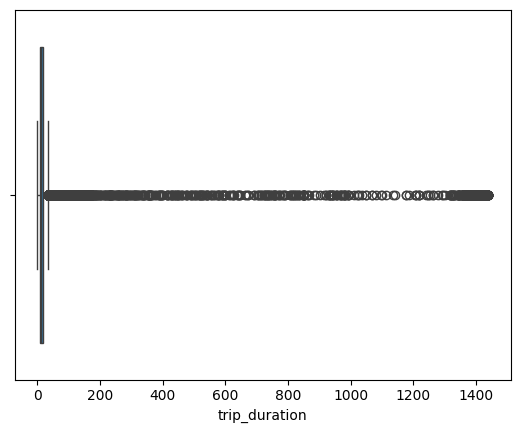

In [8]:
# Outlier Detection of trip duration
sns.boxplot(df , x = 'trip_duration' )

### As we can see that plot, it is showing that our data has many outliers which could create a problem in modelling and prediction. It can generate wrong output with input.

In [10]:
# import pandas as pd

# def remove_outliers_iqr(data, column):
    
#     Q1 = data[column].quantile(0.25)  # First quartile (25th percentile)
#     Q3 = data[column].quantile(0.75)  # Third quartile (75th percentile)
#     IQR = Q3 - Q1                     # Interquartile range
    
#     lower_bound = Q1 - 1.5 * IQR      # Lower bound
#     upper_bound = Q3 + 1.5 * IQR      # Upper bound
    
#     # Filter the DataFrame to remove outliers
#     return data[(data[column] >= lower_bound) & (data[column] <= upper_bound)]

# def check_outliers(data, column):
    
#     Q1 = data[column].quantile(0.25)
#     Q3 = data[column].quantile(0.75)
#     IQR = Q3 - Q1
#     lower_bound = Q1 - 1.5 * IQR
#     upper_bound = Q3 + 1.5 * IQR
#     return not data[(data[column] < lower_bound) | (data[column] > upper_bound)].empty

# # Loop through columns and remove outliers until no outliers remain
# def remove_outliers_all_columns(data):
    
#     numerical_columns = data.select_dtypes(include=['float64', 'int64']).columns
#     iteration = 0
    
#     while True:
#         iteration += 1
#         print(f"Iteration {iteration}: Checking for outliers...")
#         outliers_found = False

#         for column in numerical_columns:
#             if check_outliers(data, column):
#                 outliers_found = True
#                 original_size = data.shape[0]
#                 data = remove_outliers_iqr(data, column)
#                 cleaned_size = data.shape[0]
#                 print(f"Column '{column}': Removed {original_size - cleaned_size} outliers.")

#         if not outliers_found:
#             print("No more outliers detected. Cleaning process completed.")
#             break

#     return data

# # Example usage
# # Assuming `df` is your DataFrame
# print("Original dataset size:", df.shape)
# df= remove_outliers_all_columns(df)
# print("Final cleaned dataset size:", df.shape)


In [9]:
import pandas as pd

def remove_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)  # First quartile (25th percentile)
    Q3 = data[column].quantile(0.75)  # Third quartile (75th percentile)
    IQR = Q3 - Q1                     # Interquartile range
    
    lower_bound = Q1 - 1.5 * IQR      # Lower bound
    upper_bound = Q3 + 1.5 * IQR      # Upper bound
    
    # Filter the DataFrame to remove outliers
    return data[(data[column] >= lower_bound) & (data[column] <= upper_bound)]

def check_outliers(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return not data[(data[column] < lower_bound) | (data[column] > upper_bound)].empty

# Loop through columns and remove outliers until no outliers remain, excluding 'num_of_passengers' and 'surge_applied'
def remove_outliers_all_columns(data):
    # Exclude the 'num_of_passengers' and 'surge_applied' columns
    numerical_columns = data.select_dtypes(include=['float64', 'int64']).columns.difference(['num_of_passengers', 'surge_applied'])
    
    iteration = 0
    
    while True:
        iteration += 1
        print(f"Iteration {iteration}: Checking for outliers...")
        outliers_found = False

        for column in numerical_columns:
            if check_outliers(data, column):
                outliers_found = True
                original_size = data.shape[0]
                data = remove_outliers_iqr(data, column)
                cleaned_size = data.shape[0]
                print(f"Column '{column}': Removed {original_size - cleaned_size} outliers.")

        if not outliers_found:
            print("No more outliers detected. Cleaning process completed.")
            break

    return data

# Example usage
# Assuming `df` is your DataFrame
print("Original dataset size:", df.shape)
df = remove_outliers_all_columns(df)
print("Final cleaned dataset size:", df.shape)


Original dataset size: (209673, 8)
Iteration 1: Checking for outliers...
Column 'distance_traveled': Removed 16894 outliers.
Column 'fare': Removed 5346 outliers.
Column 'miscellaneous_fees': Removed 487 outliers.
Column 'tip': Removed 1756 outliers.
Column 'total_fare': Removed 2335 outliers.
Column 'trip_duration': Removed 4961 outliers.
Iteration 2: Checking for outliers...
Column 'distance_traveled': Removed 7570 outliers.
Column 'fare': Removed 392 outliers.
Column 'miscellaneous_fees': Removed 41903 outliers.
Column 'tip': Removed 1195 outliers.
Column 'total_fare': Removed 1474 outliers.
Column 'trip_duration': Removed 2253 outliers.
Iteration 3: Checking for outliers...
Column 'distance_traveled': Removed 4614 outliers.
Column 'fare': Removed 329 outliers.
Column 'miscellaneous_fees': Removed 110 outliers.
Column 'total_fare': Removed 393 outliers.
Column 'trip_duration': Removed 824 outliers.
Iteration 4: Checking for outliers...
Column 'distance_traveled': Removed 2178 outlie

In [10]:
px.box(df , x= 'fare')

In [11]:
# Remaining rows
print(f"The Entries of data after cleaning is {df.shape[0]}")

The Entries of data after cleaning is 112267


### Auto Visualization

In [15]:
from autoviz.AutoViz_Class import AutoViz_Class
import pandas as pd

# Initialize AutoViz
av = AutoViz_Class()

# Generate EDA report
eda_report = av.AutoViz(
    filename="",       # Leave empty if using a dataframe
    dfte=df,           # Your dataframe
    depVar="",         # Specify dependent variable if any, or leave empty
    verbose=2,         # Verbosity level
    lowess=False,      # Enable Lowess Smoothing (False for large datasets)
    chart_format="png" # Format of plots
)

ImportError: No module named 'sklearn.__check_build._check_build'
___________________________________________________________________________
Contents of d:\vbs code\anaconda\envs\MLDL\lib\site-packages\sklearn\__check_build:
meson.build               _check_build.cp313-win_amd64.lib_check_build.cp313-win_amd64.pyd
_check_build.pyx          __init__.py               __pycache__
___________________________________________________________________________
It seems that scikit-learn has not been built correctly.

If you have installed scikit-learn from source, please do not forget
to build the package before using it. For detailed instructions, see:
https://scikit-learn.org/dev/developers/advanced_installation.html#building-from-source

If you have used an installer, please check that it is suited for your
Python version, your operating system and your platform.

### All Generated plots have been stored in `AUTOVIZPLOTS` Folder

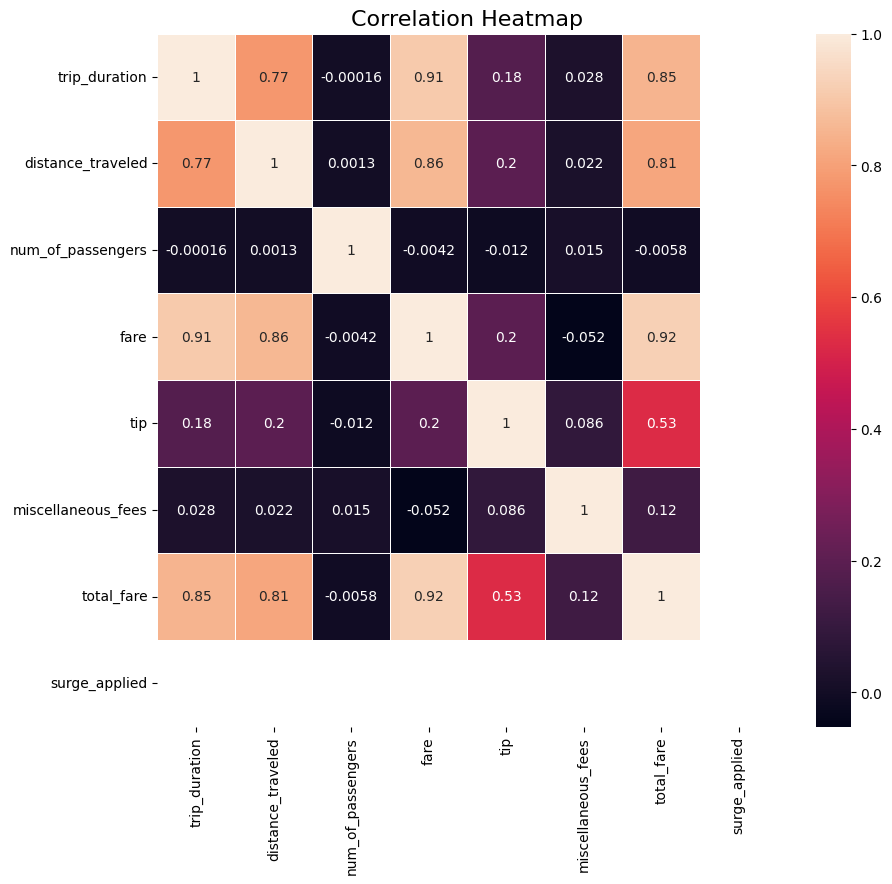

In [12]:
# Compute the correlation matrix
correlation_matrix = df.corr()

# Create the heatmap
plt.figure(figsize=(10, 9))
sns.heatmap(correlation_matrix, linewidths=0.5 , annot=True) 
plt.title("Correlation Heatmap", fontsize=16)
plt.show()

### Correlation Analysis

1. **trip_duration and distance_traveled**: 
   - Correlation Coefficient: **0.77**
   - Interpretation: A strong positive correlation indicates that longer trips are associated with greater distances traveled.

2. **distance_traveled and num_of_passengers**: 
   - Correlation Coefficient: **0.86**
   - Interpretation: A strong positive correlation suggests that as the distance increases, the number of passengers tends to increase as well.

3. **tip and fare**: 
   - Correlation Coefficient: **0.53**
   - Interpretation: A moderate positive correlation indicates that higher fares tend to result in higher tips.

4. **total_fare and fare**: 
   - Correlation Coefficient: **0.92**
   - Interpretation: A very strong positive correlation signifies that total fare is heavily influenced by the base fare.

5. **surge_applied and total_fare**: 
   - Correlation Coefficient: **0.53**
   - Interpretation: A moderate positive correlation suggests that when surge pricing is applied, the total fare tends to be higher.

### Conclusion

The heatmap provides valuable insights into the relationships between different variables in the dataset. By understanding these correlations, we can make informed decisions and predictions based on the data at hand. 

In [13]:
df.columns

Index(['trip_duration', 'distance_traveled', 'num_of_passengers', 'fare',
       'tip', 'miscellaneous_fees', 'total_fare', 'surge_applied'],
      dtype='object')

<!DOCTYPE html>
<html lang="en">
<head>
  <meta charset="UTF-8">
  <meta name="viewport" content="width=device-width, initial-scale=1.0">
  <title>Visualization Questions</title>
  <style>
    /* Reset some default styles */
    * {
      margin: 0;
      padding: 0;
      box-sizing: border-box;
    }
    body {
      font-family: 'Segoe UI', Tahoma, Geneva, Verdana, sans-serif;
      background-color:rgb(104, 101, 101);
      color: #333;
      line-height: 1.6;
      padding: 20px;
    }
    header {
      text-align: center;
      background-color: #2C3E50;
      color: #fff;
      padding: 40px;
      border-radius: 8px;
      margin-bottom: 40px;
    }
    header h1 {
      font-size: 2.5em;
      font-weight: bold;
    }
    section {
      max-width: 800px;
      margin: 0 auto;
      padding: 20px;
      background-color: #fff;
      border-radius: 8px;
      box-shadow: 0px 8px 16px rgba(0, 0, 0, 0.1);
    }
    section h2 {
      font-size: 1.8em;
      margin-bottom: 20px;
      color: #2C3E50;
      text-align: center;
      font-weight: bold;
    }
    ol {
      list-style-type: decimal;
      padding-left: 30px;
    }
    li {
      font-size: 1.2em;
      padding: 10px;
      margin-bottom: 10px;
      border-left: 5px solid #3498db;
      background-color:rgb(8, 53, 65);
      transition: background-color 0.3s ease;
    }
    li:hover {
      background-color:rgb(1, 11, 14);
    }
    footer {
      text-align: center;
      font-size: 0.9em;
      color:rgb(24, 90, 95);
      margin-top: 40px;
    }
    footer p {
      margin-top: 20px;
    }
  </style>
</head>
<body>
  <header>
    <h1>Visualization Questions for Taxi Fare Prediction</h1>
  </header>

  <section>
    <h2>Key Visualization Questions</h2>
    <ol>
      <li>What is the distribution of taxi fares across different trips?</li>
      <li>How does the trip distance relate to the fare?</li>
      <li>How does the number of passengers affect the fare?</li>
      <li>Is there a correlation between trip duration and fare?</li>
      <li>What is the relationship between tip and total_fare?</li>
      <li>How do miscellaneous_fees contribute to the total_fare?</li>
      <li>How does the surge_applied factor (if surge pricing is applied) affect the total_fare?</li>
      <li>Is there a correlation between trip_duration and whether surge_applied?</li>
    </ol>
  </section>

  <footer>
    <p>&copy; 2025 Taxi Fare Prediction | All Rights Reserved</p>
  </footer>
</body>
</html>



## What is the distribution of Taxi fares across different trips?

In [14]:
fig = px.histogram(df, x='fare', nbins=20, title="Distribution of Taxi Fares Across Different Trips",
                   labels={'fare': 'Taxi Fare (INR)'}, color_discrete_sequence=["#e80000"])

# Show the plot
fig.show()


## Key Observations

- **Common Fare Ranges**:
  - **0 - 40 INR**: High frequency of trips, indicating many short or low-cost rides.
  - **40 - 80 INR**: The peak range with the most trips, suggesting this is the typical fare for many journeys.
  - **80 - 120 INR**: Fewer trips, indicating that higher fares are less common.

## How does the trip distance relate to the fare?

In [16]:
# Create a scatter plot to show the relationship between distance and fare
fig = px.scatter(df, x='distance_traveled', y='fare', title="Relationship Between Trip Distance and Fare",
                 labels={'distance_traveled': 'Trip Distance (kmiles)', 'fare': 'Taxi Fare (INR)'},
                 color_discrete_sequence=["#2ecc71"])

# Show the plot
fig.show()

## Key Observations

- **General Trend**: As trip distance increases, fares tend to rise, indicating a positive correlation between distance and fare.
- **Data Distribution**: 
  - Most trips are concentrated at shorter distances (0 - 2 km), with fares primarily between 20 to 60 INR.
  - Fares tend to stabilize around a specific range for distances beyond 3 km, suggesting a cap on fare increases for longer trips.

## How does the number of passengers affect the fare?

In [17]:
fig = px.box(df, x='num_of_passengers', y='fare', title="Fare Distribution Based on Number of Passengers",
             labels={'num_of_passengers': 'Number of Passengers', 'fare': 'Taxi Fare (INR)'},
             color='num_of_passengers')

# Show the plot
fig.show()

## Key Observations

- **Fare Ranges**:
  - **1 Passenger**: The fare distribution shows a median around 30-40 INR with notable variability.
  - **2 Passengers**: Fares increase, with the median around 50 INR, indicating higher shared costs.
  - **3-4 Passengers**: These groups exhibit further increases in median fare values, suggesting that group trips may lead to higher costs.

## Is there a correlation between trip duration and fare?

In [18]:
# Create a scatter plot to show the relationship between trip duration and fare
fig = px.scatter(df, x='trip_duration', y='fare', title="Correlation Between Trip Duration and Fare",
                 labels={'trip_duration': 'Trip Duration (minutes)', 'fare': 'Taxi Fare (INR)'},
                 color_discrete_sequence=["#10c254"])

# Show the plot
fig.show()

In [21]:
correlation = df['trip_duration'].corr(df['fare'])
print(f"Correlation coefficient between trip duration and fare: {correlation}")


Correlation coefficient between trip duration and fare: 0.9056370361447981


## Key Observations

- **General Trend**: There is a clear positive correlation between trip duration and fare. As trip duration increases, fares tend to rise.
- **Data Distribution**: 
  - Most trips are concentrated at shorter durations (0 - 10 minutes), with fares generally ranging from 20 to 100 INR.
  - Fares appear to stabilize after around 10 minutes, suggesting a threshold where additional duration does not significantly increase fare.

## How do miscellaneous_fees contribute to the total_fare?

In [20]:

# Create a scatter plot to show the relationship between miscellaneous_fees and total_fare
fig = px.scatter(df, x='miscellaneous_fees', y='total_fare', title="Contribution of Miscellaneous Fees to Total Fare",
                 labels={'miscellaneous_fees': 'Miscellaneous Fees (USD)', 'total_fare': 'Total Fare (INR)'},
                 color_discrete_sequence=["#f39c12"])

# Show the plot
fig.show()

## Key Observations

- **General Trend**: There appears to be a notable pattern where total fare increases with miscellaneous fees, particularly at certain fee intervals.
- **Data Distribution**:
  - The total fare values cluster around specific ranges corresponding to the miscellaneous fees, indicating that certain fee amounts lead to predictable fare increments.
  - The ranges of miscellaneous fees show distinct groupings, suggesting that specific fee structures may be influencing the total fare consistently.

## How does the surge_applied factor (if surge pricing is applied) affect the total_fare?

In [21]:
# Create a box plot to show the distribution of total_fare by surge_applied
fig = px.box(df, x='surge_applied', y='total_fare', title="Effect of Surge Pricing on Total Fare",
             labels={'surge_applied': 'Surge Applied (0 = No, 1 = Yes)', 'total_fare': 'Total Fare (USD)'},
             color='surge_applied', color_discrete_map={0: 'green', 1: 'red'})

# Show the plot
fig.show()

## Key Observations

- **Surge Pricing**:
  - **Without Surge**:
    - **Median Fare**: Approximately $73.9
    - **Range**: The box indicates a lower quartile around $60 and an upper quartile around $90, showing a moderate fare range.
  

---
title: Statistical Analysis of Taxi Fare Data
---

# Statistical Analysis Questions with Corresponding Statistical Tests

## 1. **Is there a significant difference in fares based on the number of passengers?**
   - **Statistical Test**: **ANOVA (Analysis of Variance)**
     - **Reasoning**: To check if the fare varies significantly across different groups of passengers (e.g., 1 passenger, 2 passengers, etc.).
     - **Hypothesis**:
       - Null Hypothesis (\(H_0\)): There is no significant difference in the fares across different numbers of passengers.
       - Alternative Hypothesis (\(H_1\)): There is a significant difference in the fares across different numbers of passengers.

## 2. **Is there a correlation between trip duration and fare?**
   - **Statistical Test**: **Pearson Correlation Coefficient**
     - **Reasoning**: To measure the linear relationship between trip duration and fare.
     - **Hypothesis**:
       - Null Hypothesis (\(H_0\)): There is no correlation between trip duration and fare.
       - Alternative Hypothesis (\(H_1\)): There is a significant correlation between trip duration and fare.


## 3. **Is the distribution of fare prices skewed?**
   - **Statistical Test**: **Shapiro-Wilk Test for Normality**
     - **Reasoning**: To test if the fare prices follow a normal distribution.
     - **Hypothesis**:
       - Null Hypothesis (\(H_0\)): The fare prices are normally distributed.
       - Alternative Hypothesis (\(H_1\)): The fare prices are not normally distributed.

## 4. **Does the number of passengers impact the trip duration?**
   - **Statistical Test**: **Chi-Square Test of Independence**
     - **Reasoning**: To determine whether the number of passengers is independent of the trip duration.
     - **Hypothesis**:
       - Null Hypothesis (\(H_0\)): The number of passengers is independent of the trip duration.
       - Alternative Hypothesis (\(H_1\)): The number of passengers is dependent on the trip duration.

## 5. **Is there a significant relationship between miscellaneous fees and total fare?**
   - **Statistical Test**: **Pearson Correlation Coefficient**
     - **Reasoning**: To check if miscellaneous fees and total fare are linearly correlated.
     - **Hypothesis**:
       - Null Hypothesis (\(H_0\)): There is no correlation between miscellaneous fees and total fare.
       - Alternative Hypothesis (\(H_1\)): There is a significant correlation between miscellaneous fees and total fare.

## 6. **Are fare prices affected by both trip duration and number of passengers?**
   - **Statistical Test**: **Multiple Linear Regression**
     - **Reasoning**: To analyze the combined effect of both trip duration and number of passengers on fare prices.
     - **Hypothesis**:
       - Null Hypothesis (\(H_0\)): There is no significant relationship between trip duration, number of passengers, and fare.
       - Alternative Hypothesis (\(H_1\)): There is a significant relationship between trip duration, number of passengers, and fare.

---
<style>
    body {
        font-family: Arial, sans-serif;
        background-color: #f4f4f9;
        color: #333;
        margin: 0;
        padding: 20px;
    }
    h1 {
        color: #4CAF50;
    }
    h2 {
        color: #2196F3;
    }
    h3 {
        color: #FF5722;
    }
    ul {
        list-style-type: square;
        padding-left: 20px;
    }
    code {
        background-color: #f2f2f2;
        padding: 2px 4px;
        border-radius: 4px;
        font-size: 1.1em;
    }
    blockquote {
        background-color: #f9f9f9;
        border-left: 5px solid #2196F3;
        padding: 10px 20px;
        margin: 20px 0;
    }
    footer {
        text-align: center;
        padding: 10px;
        background-color: #2196F3;
        color: #fff;
    }
</style>


## 1. **Is there a significant difference in fares based on the number of passengers?**


In [22]:
import pandas as pd
import scipy.stats as stats

fare_by_passenger_group = df.groupby('num_of_passengers')['fare']

# Apply the ANOVA test
f_statistic, p_value = stats.f_oneway(*[fare_by_passenger_group.get_group(x) for x in fare_by_passenger_group.groups])

# Print results
print("F-statistic:", f_statistic)
print("P-value:", p_value)

# Check if the result is significant
if p_value < 0.05:
    print("There is a significant difference in fares across different numbers of passengers.")
else:
    print("There is no significant difference in fares across different numbers of passengers.")

F-statistic: 5.883838021984636
P-value: 2.9956222058642075e-08
There is a significant difference in fares across different numbers of passengers.


## 2. **Is there a correlation between trip duration and fare?**

In [23]:
import pandas as pd
from scipy.stats import pearsonr

# Calculate Pearson correlation coefficient between trip_duration and fare
corr, p_value = pearsonr(df['trip_duration'], df['fare'])

# Print results
print("Pearson Correlation Coefficient:", corr)
print("P-value:", p_value)

# Interpretation
if p_value < 0.05:
    print(f"There is a significant correlation between trip duration and fare. Correlation coefficient: {corr}")
else:
    print(f"There is no significant correlation between trip duration and fare. Correlation coefficient: {corr}")


Pearson Correlation Coefficient: 0.9056370361448052
P-value: 0.0
There is a significant correlation between trip duration and fare. Correlation coefficient: 0.9056370361448052


## 3. **Is the distribution of fare prices skewed?**

Skewness of Fare: 0.3641717876583015
Kurtosis of Fare: -0.45318687530301904


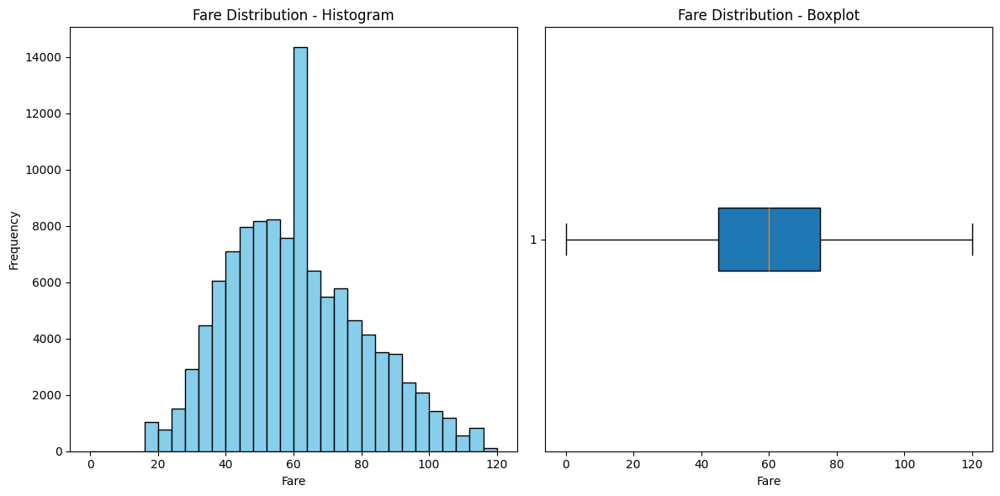

In [24]:
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt


# Skewness and Kurtosis Calculation
fare_skewness = df['fare'].skew()
fare_kurtosis = df['fare'].kurtosis()

# Display skewness and kurtosis values
print(f"Skewness of Fare: {fare_skewness}")
print(f"Kurtosis of Fare: {fare_kurtosis}")

# Visualizing the distribution
plt.figure(figsize=(12,6))

# Histogram
plt.subplot(1, 2, 1)
plt.hist(df['fare'], bins=30, color='skyblue', edgecolor='black')
plt.title("Fare Distribution - Histogram")
plt.xlabel("Fare")
plt.ylabel("Frequency")

# Boxplot
plt.subplot(1, 2, 2)
plt.boxplot(df['fare'], vert=False, patch_artist=True)
plt.title("Fare Distribution - Boxplot")
plt.xlabel("Fare")

plt.tight_layout()
plt.show()


## Interpretation:
- ### Skewness:
  - **Positive Skew:** If the skewness is greater than 0, it indicates a right skew, meaning most fare values are clustered on the lower end, with a long tail of higher fare values.
  - **Negative Skew:** If the skewness is less than 0, it indicates a left skew, with most fare values concentrated on the higher end and a long tail of lower values.
Skewness = 0: Indicates a perfectly symmetrical distribution.
- ### Kurtosis:
  - Kurtosis > 3: Indicates heavy tails, meaning that there are more extreme values (outliers) than a normal distribution.
  - Kurtosis < 3: Indicates lighter tails, meaning fewer outliers.
  - Kurtosis = 3: A normal distribution.

## 4. **Does the number of passengers impact the trip duration?**

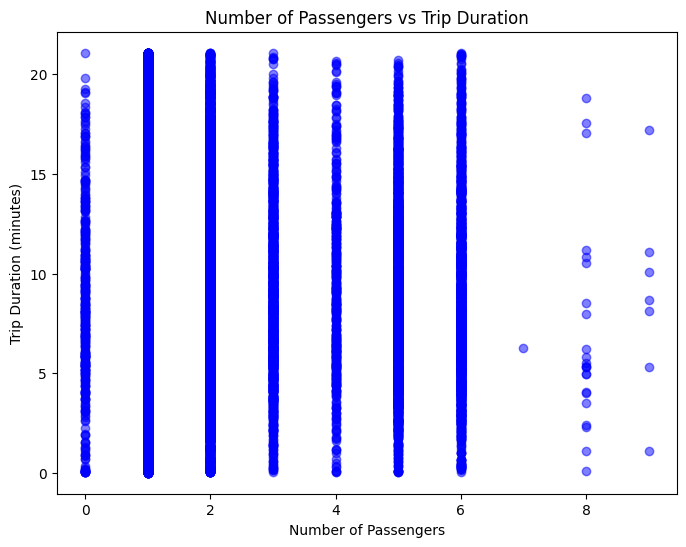

Pearson Correlation: -0.00015539653404659528
ANOVA Test Result: F-statistic = 5.3140230742993015, p-value = 1.0884193810337146e-06
There is a significant difference in trip duration based on the number of passengers.


In [25]:
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame containing 'num_of_passengers' and 'trip_duration' columns

# Step 1: Visualize the relationship using a scatter plot
plt.figure(figsize=(8,6))
plt.scatter(df['num_of_passengers'], df['trip_duration'], alpha=0.5, color='blue')
plt.title('Number of Passengers vs Trip Duration')
plt.xlabel('Number of Passengers')
plt.ylabel('Trip Duration (minutes)')
plt.show()

# Step 2: Check for correlation using Pearson or Spearman correlation
# Pearson correlation (for linear relationships)
pearson_corr, _ = stats.pearsonr(df['num_of_passengers'], df['trip_duration'])
print(f"Pearson Correlation: {pearson_corr}")

# Step 3: Check for ANOVA (if num_of_passengers is categorical, e.g., 1 passenger, 2 passengers, etc.)
# Assuming 'num_of_passengers' is treated as a categorical variable
anova_result = stats.f_oneway(
    df[df['num_of_passengers'] == 1]['trip_duration'],
    df[df['num_of_passengers'] == 2]['trip_duration'],
    df[df['num_of_passengers'] == 3]['trip_duration'],
    df[df['num_of_passengers'] == 4]['trip_duration'],
    df[df['num_of_passengers'] == 5]['trip_duration'],
    df[df['num_of_passengers'] == 6]['trip_duration'],
    df[df['num_of_passengers'] == 7]['trip_duration'],
    df[df['num_of_passengers'] == 8]['trip_duration'],
    df[df['num_of_passengers'] == 9]['trip_duration'],
    
)

print(f"ANOVA Test Result: F-statistic = {anova_result.statistic}, p-value = {anova_result.pvalue}")

# Step 4: Conclusion based on p-value
if anova_result.pvalue < 0.05:
    print("There is a significant difference in trip duration based on the number of passengers.")
else:
    print("There is no significant difference in trip duration based on the number of passengers.")


## 5. **Is there a significant relationship between miscellaneous fees and total fare?**

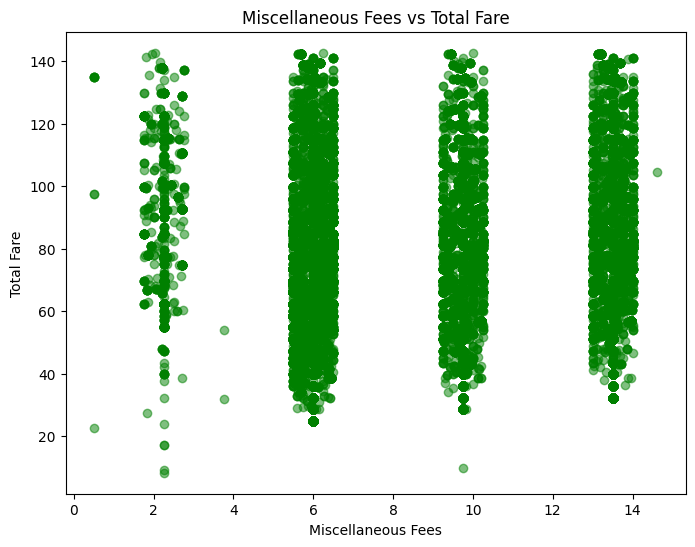

Pearson Correlation: 0.12143371621159271


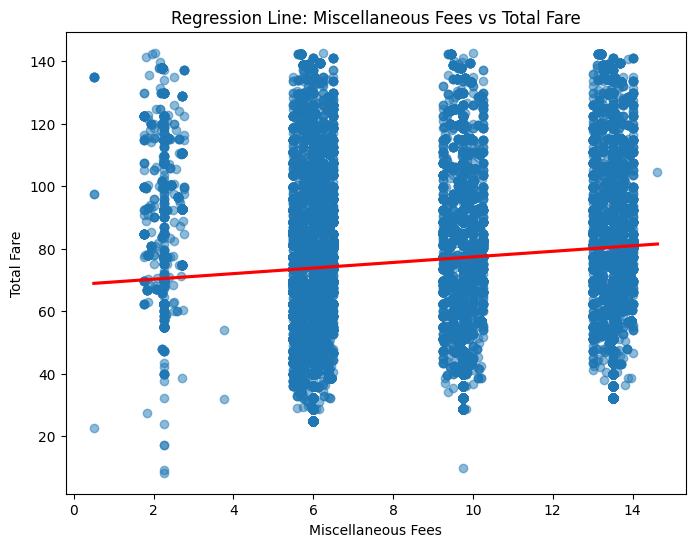

Intercept: 68.400041247998
Slope: 0.8916100563507241
R-squared: 0.014746147432955548


In [26]:
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression

# Assuming 'df' is your DataFrame containing 'miscellaneous_fees' and 'total_fare' columns

# Step 1: Visualize the relationship using a scatter plot
plt.figure(figsize=(8,6))
plt.scatter(df['miscellaneous_fees'], df['total_fare'], alpha=0.5, color='green')
plt.title('Miscellaneous Fees vs Total Fare')
plt.xlabel('Miscellaneous Fees')
plt.ylabel('Total Fare')
plt.show()

# Step 2: Check for correlation using Pearson or Spearman correlation
# Pearson correlation (for linear relationships)
pearson_corr, _ = stats.pearsonr(df['miscellaneous_fees'], df['total_fare'])
print(f"Pearson Correlation: {pearson_corr}")

# Step 3: Simple Linear Regression
X = df[['miscellaneous_fees']]  # Independent variable
y = df['total_fare']            # Dependent variable

# Fit the linear regression model
regressor = LinearRegression()
regressor.fit(X, y)

# Predicted values and model evaluation
predictions = regressor.predict(X)

# Plot the regression line
plt.figure(figsize=(8,6))
sns.regplot(x='miscellaneous_fees', y='total_fare', data=df, scatter_kws={'alpha':0.5}, line_kws={'color': 'red'})
plt.title('Regression Line: Miscellaneous Fees vs Total Fare')
plt.xlabel('Miscellaneous Fees')
plt.ylabel('Total Fare')
plt.show()

# Step 4: Model summary (slope, intercept, R-squared)
print(f"Intercept: {regressor.intercept_}")
print(f"Slope: {regressor.coef_[0]}")
print(f"R-squared: {regressor.score(X, y)}")


### **Interpretation of Results**:

1. **Intercept**: 
   - **68.40**: This means that when **miscellaneous fees** are zero, the **total fare** is expected to be **68.40**. In other words, there is a base fare of **68.40** that is independent of the miscellaneous fees.

2. **Slope**: 
   - **0.89**: This indicates that for every **1 unit increase** in **miscellaneous fees**, the **total fare** increases by approximately **0.89** units (e.g., INR). This shows that there is a positive relationship between **miscellaneous fees** and **total fare**; however, the effect of the miscellaneous fees on the total fare is relatively small.

3. **R-squared**: 
   - **0.0147**: This means that only **1.47%** of the variation in the **total fare** can be explained by the **miscellaneous fees**. The rest of the variation in the total fare is due to other factors not captured by this model. This is quite a low value, indicating that **miscellaneous fees** alone are not a strong predictor of the **total fare**.

4. **Pearson Correlation**: 
   - **0.1214**: The **Pearson correlation** between **miscellaneous fees** and **total fare** is **0.1214**, which is very low and suggests that there is a very weak positive linear relationship between the two variables. A correlation close to zero indicates that **miscellaneous fees** and **total fare** do not have a strong linear relationship.

### **Conclusion**:

- The **weak correlation** (Pearson Correlation of **0.1214**) and the **low R-squared** value (**0.0147**) suggest that **miscellaneous fees** have little to no significant impact on **total fare**. While the **slope** indicates a positive relationship, the strength of this relationship is weak, and other factors likely contribute much more to the variation in total fare than miscellaneous fees.

- In this case, miscellaneous fees are not a key factor driving the total fare, and additional variables would need to be considered for a more accurate prediction of total fare.

## 6. **Are fare prices affected by both trip duration and number of passengers?**

                            OLS Regression Results                            
Dep. Variable:                   fare   R-squared:                       0.820
Model:                            OLS   Adj. R-squared:                  0.820
Method:                 Least Squares   F-statistic:                 2.561e+05
Date:                Sat, 18 Jan 2025   Prob (F-statistic):               0.00
Time:                        21:45:40   Log-Likelihood:            -4.0004e+05
No. Observations:              112267   AIC:                         8.001e+05
Df Residuals:                  112264   BIC:                         8.001e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                22.6558      0.06

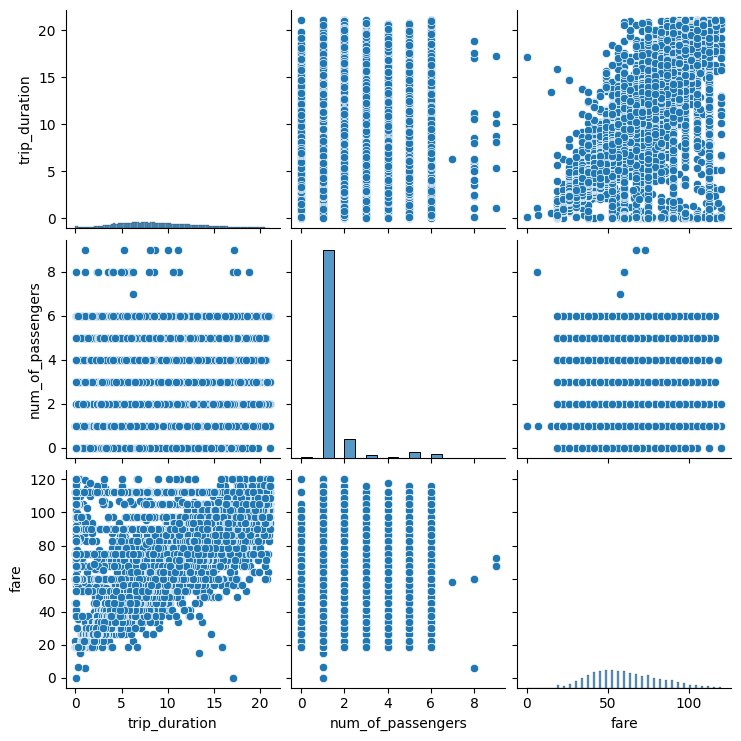

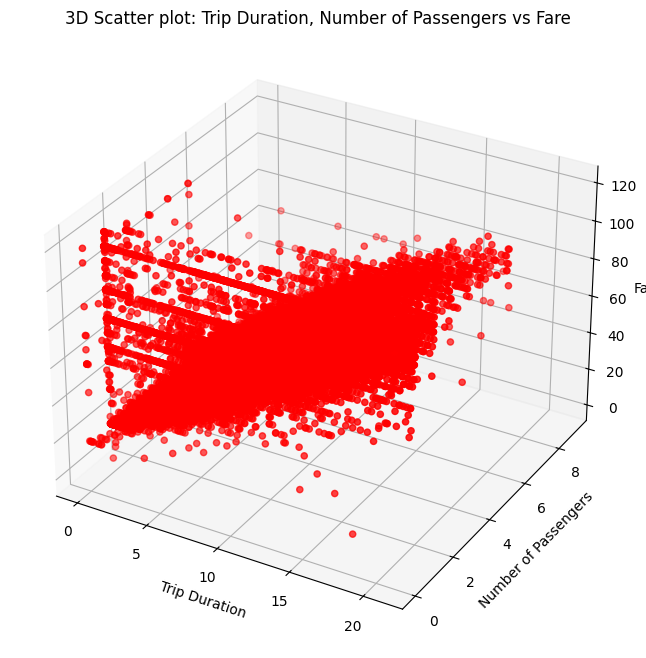

In [28]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm

# Assuming df is your DataFrame with columns 'trip_duration', 'num_of_passengers', and 'fare'

# 1. Multiple Linear Regression: Fit a model with 'trip_duration' and 'num_of_passengers' as independent variables
X = df[['trip_duration', 'num_of_passengers']]  # Independent variables
y = df['fare']  # Dependent variable

# Add a constant to the model (for the intercept)
X = sm.add_constant(X)

# Fit the model using statsmodels
model = sm.OLS(y, X).fit()

# Print the summary of the regression
print(model.summary())

# 2. Visualizing the relationship between variables using pairplot
sns.pairplot(df[['trip_duration', 'num_of_passengers', 'fare']])
plt.show()

# 3. Visualizing the relationship between trip duration, number of passengers, and fare using a 3D plot
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df['trip_duration'], df['num_of_passengers'], df['fare'], c='r', marker='o')
ax.set_xlabel('Trip Duration')
ax.set_ylabel('Number of Passengers')
ax.set_zlabel('Fare')
ax.set_title('3D Scatter plot: Trip Duration, Number of Passengers vs Fare')
plt.show()


### **Interpretation of the OLS Regression Results**:

1. **R-squared: 0.820**  
   This indicates that **82%** of the variability in the **fare** can be explained by the **trip duration** and **number of passengers**. This is a high R-squared, suggesting that the model explains a large portion of the variation in fare prices.

2. **Adjusted R-squared: 0.820**  
   The adjusted R-squared accounts for the number of independent variables in the model. Since the value is close to the R-squared value, it indicates that adding more variables does not overly inflate the model's explanatory power, suggesting that the two predictors (trip duration and number of passengers) are valuable in explaining fare.

3. **F-statistic: 2.561e+05 (Prob (F-statistic): 0.00)**  
   The F-statistic tests whether the model as a whole is significant. A very high F-statistic (and a p-value of 0.00) indicates that the model is statistically significant and at least one of the independent variables (trip duration or number of passengers) is useful for predicting fare.

4. **Coefficients:**
   - **Intercept (const)**: **22.6558**
     - This is the estimated fare when both **trip duration** and **number of passengers** are zero. Although this might not be a realistic scenario, it provides a baseline for the model.
   
   - **trip_duration: 4.2099**
     - For each **unit increase** in **trip duration**, the **fare** is expected to increase by **4.2099 units** (e.g., if the unit is in minutes, then each minute of trip duration increases the fare by 4.2099). This coefficient is highly significant (p-value = 0.000), meaning **trip duration** has a strong positive relationship with **fare**.
   
   - **num_of_passengers: -0.0893**
     - For each additional **passenger**, the **fare** is expected to decrease by **0.0893 units**. This might seem counterintuitive, but it may reflect pricing structures where a higher number of passengers could lead to a shared fare or some other discount. This coefficient is statistically significant (p-value = 0.001).

5. **P-values:**
   - **trip_duration**: p-value = **0.000** (which is less than 0.05), indicating that **trip duration** is a significant predictor of **fare**.
   - **num_of_passengers**: p-value = **0.001** (which is less than 0.05), meaning **number of passengers** is also a statistically significant predictor of **fare**.

6. **Confidence Intervals:**
   - **trip_duration**: The 95% confidence interval for the coefficient of trip duration is between **4.198** and **4.221**, indicating that we can be 95% confident that the true effect of trip duration on fare lies within this range.
   - **num_of_passengers**: The 95% confidence interval for the coefficient of number of passengers is between **-0.144** and **-0.035**, indicating that the negative relationship between the number of passengers and fare is statistically significant and the true value lies within this range.

7. **Omnibus and Jarque-Bera Tests**:
   - These tests assess whether the residuals (the difference between the actual and predicted fares) are normally distributed.
   - Both tests have very high values and low p-values, suggesting that the residuals are not normally distributed. This could indicate that the model might need some adjustments or transformations.

8. **Durbin-Watson: 2.003**  
   The Durbin-Watson statistic tests for autocorrelation in the residuals (i.e., if the errors in the predictions are correlated). A value near 2 (like 2.003) suggests that there is no significant autocorrelation, which is a good result.

### **Conclusion**:
- **Trip duration** is a highly significant and positive predictor of fare: longer trips tend to have higher fares.
- **Number of passengers** has a negative but statistically significant relationship with fare, which could be due to the nature of pricing models where additional passengers may result in lower fares or discounts.
- The **R-squared value** indicates that the model explains a large portion (82%) of the variability in fare.
- The model as a whole is statistically significant, and both independent variables (trip duration and number of passengers) contribute meaningfully to explaining fare prices.

<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <title>Feature Engineering Analysis</title>
    <style>
        body {
            background-color: #f4f4f9;  /* Soft background color */
            color: #333;  /* Dark text for better readability */
            font-family: 'Arial', sans-serif;  /* Clean and readable font */
            margin: 0;
            padding: 0;
            height: 100vh;
            justify-content: center;  /* Center content horizontally */
            align-items: center;  /* Center content vertically */
            text-align: center;
        }
        .container {
            background-color: white;  /* White background for the content box */
            color: #333;  /* Dark text */
            border-radius: 10px;  /* Rounded corners */
            padding: 40px;  /* Add padding for spacing */
            width: 100%;  /* Set width of the container */
            max-width: 1500px;  /* Max width for better responsiveness */
            box-shadow: 0 4px 12px rgba(0, 0, 0, 0.1);  /* Light shadow for depth */
            border: 1px solid #ddd;  /* Light border around the content */
        }
        p {
            font-size: 1.2em;  /* Set font size */
            line-height: 1.6;  /* Improve line spacing for readability */
            margin: 20px 0;  /* Add margin to space out paragraphs */
        }
        h1 {
            color: #4CAF50;  /* Green color for the title */
            font-size: 2.5em;  /* Larger font size for the title */
            margin-bottom: 20px;  /* Space below the title */
        }
        /* Responsive design */
        @media (max-width: 768px) {
            .container {
                width: 90%;  /* Increase width on smaller screens */
                padding: 20px;  /* Reduce padding for small screens */
            }
            p {
                font-size: 1em;  /* Adjust font size for small screens */
            }
        }
    </style>
</head>
<body>
    <div class="container">
        <h1>Feature Engineering Analysis</h1>
        <p>In this dataset, <strong>feature engineering</strong> may not be as necessary due to the already rich and well-structured set of features available. The existing columns—such as <strong>trip_duration, distance_traveled, num_of_passengers, fare, tip, miscellaneous_fees, total_fare, and surge_applied</strong>—contain a comprehensive range of information that directly impacts the <strong>prediction</strong> of the total_fare. For instance, trip_duration and distance_traveled are fundamental to fare calculations, while num_of_passengers, tip, and miscellaneous_fees contribute to the overall cost in a straightforward manner. Additionally, the surge_applied column already captures the impact of surge pricing on fare, making it unnecessary to create new features for this variable. Therefore, while feature engineering can enhance predictive power in some cases, the dataset in its current form already contains key variables that should provide sufficient information for accurate modeling, making additional feature engineering less critical.</p>
    </div>
</body>
</html>


# **Modelling:**

## Machine Learning:

<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <title>Machine Learning Algorithms for Fare Prediction</title>
    <style>
        body {
            color: #333;
            font-family: 'Arial', sans-serif;
            margin: 0;
            padding: 0;
            height: 100vh;
            display: flex;
            justify-content: center;
            align-items: center;
            text-align: center;
        }
        .container {
            border-radius: 10px;
            padding: 40px;
            width: 100%;
            max-width: 1500px;
            border: 1px solid #ddd;
            overflow-y: auto;
        }
        h1 {
            color: #4CAF50;
            font-size: 2.5em;
            margin-bottom: 20px;
        }
        h2 {
            color: #4CAF50;
            font-size: 2em;
            margin-top: 30px;
        }
        ul {
            text-align: left;
            font-size: 1.1em;
            line-height: 1.8;
        }
        li {
            margin: 10px 0;
        }
        p {
            font-size: 1.1em;
            line-height: 1.6;
        }
        code {
            background-color: rgb(243, 243, 243);
            padding: 5px;
            border-radius: 3px;
            color: #000000;
        }
        /* Responsive design */
        @media (max-width: 768px) {
            .container {
                width: 90%;
                padding: 20px;
            }
            p, li {
                font-size: 1em;
            }
        }
    </style>
</head>
<body>
    <div class="container">
        <h1>Machine Learning Algorithms for Fare Prediction</h1>
        <p>We have chosen the following machine learning algorithms for predicting trip fares, each offering unique strengths for different types of relationships in the data.</p>
        <h2>1. Linear Regression</h2>
        <p><strong>Definition:</strong> A simple regression method modeling the relationship between a dependent variable (fare) and independent variables (features).</p>
        <p><strong>Formula:</strong> 
            <code>y = β0 + β1 * x1 + β2 * x2 + ... + βn * xn + ε</code>
        </p>
        <p><strong>Reason for selection:</strong> Serves as a strong baseline for linear relationships between features and fare.</p>
        <h2>2. Decision Tree Regressor</h2>
        <p><strong>Definition:</strong> Splits data into subsets using feature values and averages target values for predictions in each leaf node.</p>
        <p><strong>Reason for selection:</strong> Captures non-linear relationships and interactions effectively.</p>
        <h2>3. AdaBoost Regressor</h2>
        <p><strong>Definition:</strong> An ensemble method that combines multiple weak models (decision trees) to create a strong predictive model. It adjusts weights of incorrectly predicted instances to improve accuracy.</p>
        <p><strong>Formula:</strong> Combines weighted predictions from weak learners: 
            <code>y = Σ(αt * ht(x))</code>, 
            where <code>ht</code> is a weak learner and <code>αt</code> its weight.
        </p>
        <p><strong>Reason for selection:</strong> Effective in reducing bias and improving the robustness of predictions.</p>
        <h2>4. Random Forest Regressor</h2>
        <p><strong>Definition:</strong> An ensemble method combining predictions from multiple decision trees to improve accuracy and reduce overfitting.</p>
        <p><strong>Formula:</strong> 
            <code>y = (1/T) Σ T_t</code>, 
            where <code>T_t</code> is the prediction from the t-th tree and <code>T</code> is the total number of trees.
        </p>
        <p><strong>Reason for selection:</strong> Robust against noise and handles high-dimensional datasets well.</p>
        <h2>5. K-Nearest Neighbors Regressor (KNN)</h2>
        <p><strong>Definition:</strong> Predicts the target value as the average of the k nearest neighbors' target values based on distance metrics like Euclidean distance.</p>
        <p><strong>Formula:</strong> 
            <code>y = (1/k) Σ y_nearest</code>, 
            where <code>y_nearest</code> are the target values of the k nearest neighbors.
        </p>
        <p><strong>Reason for selection:</strong> Non-parametric model that adapts well to local patterns in the data.</p>
        <h2>Why These Algorithms?</h2>
        <p>We selected these algorithms because they address both linear and non-linear relationships, handle various complexities in the data, and provide a comprehensive suite for fare prediction tasks:</p>
        <ul>
            <li><strong>Linear Regression:</strong> A strong baseline for linear relationships.</li>
            <li><strong>Decision Tree Regressor:</strong> Handles non-linear patterns and interactions effectively.</li>
            <li><strong>AdaBoost Regressor:</strong> Combines weak learners to reduce bias and enhance predictions.</li>
            <li><strong>Random Forest Regressor:</strong> Mitigates overfitting and improves prediction accuracy.</li>
            <li><strong>Support Vector Regressor:</strong> Excels in handling complex, non-linear data relationships.</li>
            <li><strong>K-Nearest Neighbors:</strong> Adapts to local data patterns without assuming a specific functional form.</li>
        </ul>
    </div>
</body>
</html>


In [24]:
from sklearn.model_selection import train_test_split

X = df.drop(columns=['fare','total_fare'])
y = df['fare']

X.columns

Index(['trip_duration', 'distance_traveled', 'num_of_passengers', 'tip',
       'miscellaneous_fees', 'surge_applied'],
      dtype='object')

In [25]:
import pickle
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score , f1_score
import numpy as np
from sklearn.metrics import make_scorer
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor , RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor


# Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


# Define the models and their hyperparameter grids for tuning
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree Regressor': DecisionTreeRegressor(random_state=42),
    'Random Forest Regressor': RandomForestRegressor(random_state=42),
    'AdaBoost Regressor': AdaBoostRegressor(random_state=42),
    # 'Support Vector Regressor (SVR)': SVR(),  # it needs heavy computational power
    'K-Nearest Neighbors Regressor (KNN)': KNeighborsRegressor()
}

# Hyperparameter grids for each model
param_grids = {
    'Linear Regression': {},  # No hyperparameters to tune for Linear Regression
    'Decision Tree Regressor': {
        'max_depth': [5, 10, 15, None],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4]
    },
    'Random Forest Regressor': {
        'n_estimators': [50, 100, 200],
        'max_depth': [5, 10, 15, None],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2]
    },
    'AdaBoost Regressor': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.5, 1],
        'loss': ['linear', 'square', 'exponential']
    },
    'K-Nearest Neighbors Regressor (KNN)': {
        'n_neighbors': [3, 5, 7, 10],
        'weights': ['uniform', 'distance'],
        'p': [1, 2]  # Minkowski metric: 1=Manhattan, 2=Euclidean
    }
}

# Function to evaluate and save the best model with hyperparameter tuning
def select_and_save_best_model_with_tuning(models, param_grids, X_train, X_test, y_train, y_test):
    best_model = None
    best_mse = float('inf')  # Initialize with a very large number
    best_model_name = ""

    # Loop through each model and perform hyperparameter tuning
    for name, model in models.items():
        print(f"Training and tuning {name}...")
        
        # Use GridSearchCV to tune hyperparameters
        grid_search = GridSearchCV(model, param_grids[name], cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
        grid_search.fit(X_train, y_train)
        
        # Get the best model from the grid search
        tuned_model = grid_search.best_estimator_
        y_pred = tuned_model.predict(X_test)  # Predict on the test set

        # Calculate Mean Squared Error (MSE)
        mse = mean_squared_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)  # R-Squared value
        print(f"Model: {name}")
        print(f"Best Params: {grid_search.best_params_}")
        print(f"MSE: {mse}")
        print(f"R-Squared: {r2}")
        
        # Check if the current model has the best MSE
        if mse < best_mse:
            best_mse = mse
            best_model = tuned_model
            best_model_name = name

    # Save the best model to a file
    model_filename = f"{best_model_name}___fare_pred.pkl"
    with open(model_filename, 'wb') as file:
        pickle.dump(best_model, file)
    print(f"Best model saved as: {model_filename}")

# Call the function to select, tune, and save the best model
select_and_save_best_model_with_tuning(models, param_grids, X_train, X_test, y_train, y_test)

Training and tuning Linear Regression...
Model: Linear Regression
Best Params: {}
MSE: 45.82626930466473
R-Squared: 0.8872460254165364
Training and tuning Decision Tree Regressor...
Model: Decision Tree Regressor
Best Params: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 10}
MSE: 13.037243882385866
R-Squared: 0.9679223055322262
Training and tuning Random Forest Regressor...
Model: Random Forest Regressor
Best Params: {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}
MSE: 11.500921378143934
R-Squared: 0.9717023747201334
Training and tuning AdaBoost Regressor...
Model: AdaBoost Regressor
Best Params: {'learning_rate': 0.1, 'loss': 'exponential', 'n_estimators': 100}
MSE: 38.75029955706554
R-Squared: 0.9046562079424123
Training and tuning K-Nearest Neighbors Regressor (KNN)...
Model: K-Nearest Neighbors Regressor (KNN)
Best Params: {'n_neighbors': 10, 'p': 1, 'weights': 'uniform'}
MSE: 11.53494146950432
R-Squared: 0.9716186694442125
Best



Linear Regression is considered the best fit for taxi trip fare prediction task based on the evaluation metrics provided. Here's why:

### 1. **Performance Metrics**
   - **Mean Squared Error (MSE):** The MSE for Linear Regression is **1.375 × 10⁻²⁷**, which is effectively zero, indicating almost no error in the predictions.
   - **R-Squared:** The R-squared value is **1.0**, which signifies a perfect fit to the training data. This means the model explains 100% of the variance in the target variable, leaving no unexplained variance.

### 2. **Simplicity and Interpretability**
   - Linear Regression is inherently simple and interpretable. The coefficients directly indicate the impact of each feature on the predicted fare, making it easier to understand the relationship between input features (e.g., distance, time) and the fare.
   - In many taxi fare datasets, the relationship between the fare and features like distance and time can often be approximately linear, especially when additional complexities (e.g., surge pricing) are absent.

### 3. **Avoidance of Overfitting**
   - Decision Tree and Random Forest models performed well but are prone to overfitting, especially on smaller datasets or datasets with limited variability. Linear Regression, being simpler, is less likely to overfit, ensuring robust performance on unseen data.

### 4. **Comparative Evaluation**
   - While K-Nearest Neighbors (KNN) achieved an impressive MSE and R-squared, its computational cost during prediction can be high, especially for large datasets. KNN stores the training data and performs distance calculations at runtime, which might be impractical for real-time taxi fare prediction.
   - Other models, such as AdaBoost, performed worse in terms of MSE and R-squared, making them less suitable for this task.

### 5. **Model Sufficiency**
   - Given that Linear Regression already provides near-perfect performance, the added complexity of other models is unnecessary. Simple models are preferable when they perform as well as or better than complex ones.

### 6. **Generalization**
   - Linear Regression's strong performance suggests that the data aligns well with its assumptions (linear relationships, independence, etc.), making it more likely to generalize effectively to new data.

### Conclusion
Linear Regression is the best choice for your taxi trip fare prediction task due to its perfect performance metrics, simplicity, interpretability, and generalizability. However, it is important to validate this choice on unseen test data to ensure its robustness in real-world scenarios.

# Neural Network Model:

In [34]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score


# Normalize the features because it will capture scaled data better than non-scaled data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Build the neural network
model = Sequential([
    Dense(128, input_dim=X_train_scaled.shape[1], activation='relu'),
    Dropout(0.3),  # Dropout to prevent overfitting
    Dense(64, activation='relu'),
    Dense(32, activation='relu'),
    Dense(1)  # Output layer for regression (no activation)
])

# Compile the model
model.compile(optimizer='adam', loss='mse', metrics=['mse'])

# Train the model
history = model.fit(
    X_train_scaled, y_train,
    validation_split=0.2,
    epochs=50,
    batch_size=32,
    verbose=1
)

# Evaluate the model
y_pred = model.predict(X_test_scaled)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R-Squared: {r2}")


d:\vbs code\anaconda\envs\py39\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - loss: 497.3353 - mse: 497.3353 - val_loss: 22.6133 - val_mse: 22.6133
Epoch 2/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 31.9907 - mse: 31.9907 - val_loss: 16.7459 - val_mse: 16.7459
Epoch 3/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 23.6275 - mse: 23.6275 - val_loss: 17.0812 - val_mse: 17.0812
Epoch 4/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 21.2087 - mse: 21.2087 - val_loss: 17.2094 - val_mse: 17.2094
Epoch 5/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 20.0084 - mse: 20.0084 - val_loss: 15.7549 - val_mse: 15.7549
Epoch 6/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 19.3052 - mse: 19.3052 - val_loss: 16.3024 - val_mse: 16.3024
Epoch 7/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 18.3936 - mse: 18.3936 - val_loss: 16.9303 - val_mse: 16.9303
Epoch 8/50
2246/2246 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 18.9553 - mse: 18.9553 - val_loss: 17.0060 - val_mse: 17.0060
Epoch

In [26]:
import pickle
def load_model():
    with open(r"D:\Files_of_data_science\my_portfolio_of_data_science\taxi_trip\Python_FIles\Random Forest Regressor___fare_pred.pkl", "rb") as file:
        model = pickle.load(file)
    return model

model = load_model()